# Explainable AI for Healthcare Imaging with TensorBoard Profiling

This notebook demonstrates how to build, profile, and interpret an AI model for healthcare imaging, specifically for classifying chest X-rays as normal or showing signs of pneumonia.

## Profiling in AI for Healthcare

Profiling is crucial in AI for healthcare for several reasons:

1. **Performance Optimization**: In healthcare, rapid and efficient model performance can be critical. Profiling helps identify bottlenecks and optimize resource usage.

2. **Resource Management**: Healthcare institutions often have limited computational resources. Profiling ensures efficient use of these resources.

3. **Model Transparency**: In healthcare, it's vital to understand how models make decisions. Profiling tools like TensorBoard help visualize the inner workings of our models.

4. **Regulatory Compliance**: Healthcare AI often needs to meet strict regulatory standards. Profiling can help document model behavior and performance for audits.

5. **Continuous Improvement**: By understanding model behavior over time, we can continually refine and improve our healthcare AI systems.

In this notebook, we'll use TensorBoard for profiling, which offers several key benefits:

- **Metric Tracking**: We'll log and visualize key metrics like loss, accuracy, precision, recall, and F1 score.
- **Parameter Distribution Visualization**: This helps us understand how our model's parameters change during training.
- **Sample Predictions**: We'll periodically log sample images and predictions, allowing us to visually inspect our model's performance.
- **Model Graph Visualization**: This gives us a clear view of our model's architecture.
- **Resource Usage Monitoring**: TensorBoard can help us track CPU, GPU, and memory usage during training.

Let's get started!

## Setup

First, let's install the necessary libraries:

In [1]:
!pip install torch torchvision captum scikit-learn seaborn pandas tensorboard

Now, let's import the required libraries:

In [2]:
import os
import time
import copy
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import seaborn as sns
import pandas as pd

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.optim import lr_scheduler
from torch.utils.tensorboard import SummaryWriter
from torch.autograd import Variable

import torchvision
from torchvision import datasets, models, transforms

from sklearn.metrics import confusion_matrix, precision_recall_fscore_support

from captum.attr import IntegratedGradients, GradientShap, Occlusion, NoiseTunnel
from captum.attr import visualization as viz

## Download and Prepare the Dataset

We'll use a chest X-ray dataset. Let's download and extract it:

In [3]:
!if [ ! -f ChestXRay2017.zip ]; then gdown --fuzzy https://drive.google.com/file/d/1jf1XvAeXPD4XAerknz5inxM0StuCNbyX/view?usp=sharing; unzip ChestXRay2017.zip; fi

Now, let's set up our data transformations and load the dataset:

In [4]:
# Configuration
data_dir = 'chest_xray'
batch_size = 4
num_workers = 0
epoch_num = 25
lr = 1e-3

# Data transforms
data_transforms = {
    'train': transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
        transforms.RandomResizedCrop(size=(300,300),antialias=True)
    ]),
    'test': transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
        transforms.RandomResizedCrop(size=(300,300),antialias=True)
    ]),
}

# Load datasets
image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x), data_transforms[x])
                  for x in ['train', 'test']}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=batch_size,
                                              shuffle=True, num_workers=num_workers)
               for x in ['train', 'test']}
dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'test']}
class_names = image_datasets['train'].classes

# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("device:", device)
print("classes:", class_names)

device: cuda
classes: ['NORMAL', 'PNEUMONIA']


## Define the Model and Training Function

Now, let's define our model (we'll use a pre-trained ResNet18) and the training function with TensorBoard logging.

### Profiling Note:
In the training function, we're using TensorBoard to log several important metrics:
- Loss and accuracy for both training and testing phases
- Precision, recall, and F1 score
- Histograms of model parameters
- Sample images and their predictions

These logs will help us understand how our model is performing over time and identify any issues in training.

In [5]:
def train_model(model, criterion, optimizer, scheduler, num_epochs=25):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    # Initialize TensorBoard writer
    writer = SummaryWriter()

    for epoch in range(num_epochs):
        print(f'Epoch {epoch}/{num_epochs - 1}')
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'test']:
            if phase == 'train':
                model.train()
            else:
                model.eval()

            running_loss = 0.0
            running_corrects = 0
            all_preds = []
            all_labels = []

            # Iterate over data.
            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
                all_preds.extend(preds.cpu().numpy())
                all_labels.extend(labels.cpu().numpy())

            if phase == 'train':
                scheduler.step()

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

            # Calculate precision, recall, and F1 score
            precision, recall, f1, _ = precision_recall_fscore_support(all_labels, all_preds, average='weighted')

            # Log metrics to TensorBoard
            writer.add_scalar(f'{phase}/Loss', epoch_loss, epoch)
            writer.add_scalar(f'{phase}/Accuracy', epoch_acc, epoch)
            writer.add_scalar(f'{phase}/Precision', precision, epoch)
            writer.add_scalar(f'{phase}/Recall', recall, epoch)
            writer.add_scalar(f'{phase}/F1', f1, epoch)

            # Log histograms of model parameters
            for name, param in model.named_parameters():
                writer.add_histogram(f'{phase}/{name}', param.clone().cpu().data.numpy(), epoch)

            # Log sample images and their predictions (first batch only)
            if epoch % 5 == 0:  # Log every 5 epochs to save space
                img_grid = torchvision.utils.make_grid(inputs[:4])
                writer.add_image(f'{phase}/sample_images', img_grid, epoch)
                writer.add_text(f'{phase}/predictions', f'Pred: {preds[:4]}, True: {labels[:4]}', epoch)

            # deep copy the model
            if phase == 'test' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

        print()

    time_elapsed = time.time() - since
    print(f'Training complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
    print(f'Best test Acc: {best_acc:4f}')

    # Close TensorBoard writer
    writer.close()

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model

# Initialize the model
model_ft = models.resnet18(pretrained=False)
if torch.cuda.device_count() > 1:
    print("Using", torch.cuda.device_count(), "GPUs!")
    model_ft = nn.DataParallel(model_ft)

num_ftrs = model_ft.fc.in_features
model_ft.fc = nn.Linear(num_ftrs, 2)
model_ft = model_ft.to(device)

# Set up loss function, optimizer, and learning rate scheduler
criterion = nn.CrossEntropyLoss()
optimizer_ft = optim.SGD(model_ft.parameters(), lr=lr, momentum=0.9)
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


## Train the Model

Now, let's train our model. This process will log various metrics to TensorBoard, allowing us to profile our model's performance over time.

In [6]:
# Train the model
model_ft = train_model(model_ft, criterion, optimizer_ft, exp_lr_scheduler, num_epochs=epoch_num)

# Log model graph
writer = SummaryWriter()
dummy_input = torch.rand(1, 3, 300, 300).to(device)
writer.add_graph(model_ft, dummy_input)
writer.close()

Epoch 0/24
----------
train Loss: 0.5086 Acc: 0.7747
test Loss: 0.4720 Acc: 0.7853

Epoch 1/24
----------
train Loss: 0.4106 Acc: 0.8156
test Loss: 0.4913 Acc: 0.8109

Epoch 2/24
----------
train Loss: 0.3865 Acc: 0.8352
test Loss: 0.4562 Acc: 0.8125

Epoch 3/24
----------
test Loss: 0.4201 Acc: 0.8253

Epoch 4/24
----------
train Loss: 0.3250 Acc: 0.8662
test Loss: 1.0195 Acc: 0.6571

Epoch 5/24
----------
train Loss: 0.2793 Acc: 0.8870
test Loss: 0.3761 Acc: 0.8590

Epoch 6/24
----------
train Loss: 0.2792 Acc: 0.8853
test Loss: 0.5405 Acc: 0.7965

Epoch 7/24
----------
train Loss: 0.2245 Acc: 0.9077
test Loss: 0.4202 Acc: 0.8494

Epoch 8/24
----------
train Loss: 0.2211 Acc: 0.9144
test Loss: 0.4323 Acc: 0.8510

Epoch 9/24
----------
train Loss: 0.2136 Acc: 0.9182
test Loss: 0.3661 Acc: 0.8558

Epoch 10/24
----------
train Loss: 0.2074 Acc: 0.9222
test Loss: 0.4265 Acc: 0.8542

Epoch 11/24
----------
train Loss: 0.2077 Acc: 0.9176
test Loss: 0.3928 Acc: 0.8670

Epoch 12/24
---------

### Profiling Note:
The `add_graph` function logs the model's architecture to TensorBoard. This is crucial for understanding the model's structure and can help identify potential bottlenecks or areas for optimization.

## Evaluate the Model

After training, let's evaluate our model using a confusion matrix. This will give us insights into the model's performance across different classes.

tensor([[163.,  71.],
        [  8., 382.]])
tensor([0.6966, 0.9795])


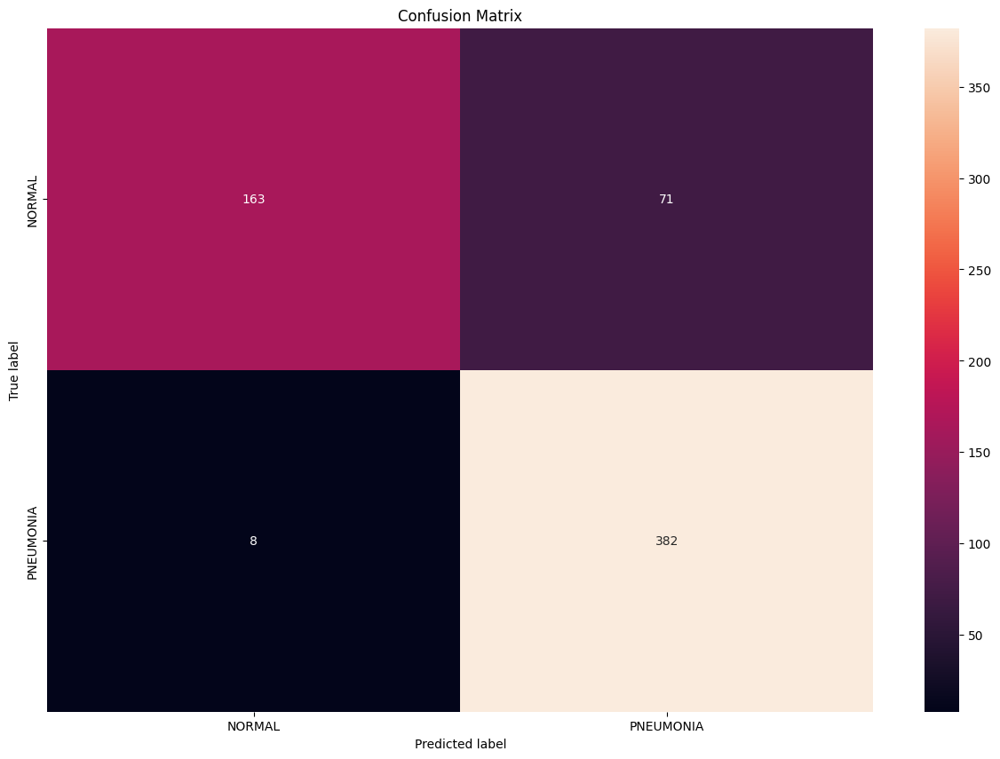

In [7]:
# Confusion Matrix
nb_classes = 2
confusion_matrix = torch.zeros(nb_classes, nb_classes)
with torch.no_grad():
    for i, (inputs, classes) in enumerate(dataloaders['test']):
        inputs = inputs.to(device)
        classes = classes.to(device)
        outputs = model_ft(inputs)
        _, preds = torch.max(outputs, 1)
        for t, p in zip(classes.view(-1), preds.view(-1)):
            confusion_matrix[t.long(), p.long()] += 1

print(confusion_matrix)
print(confusion_matrix.diag()/confusion_matrix.sum(1))

# Plot confusion matrix
plt.figure(figsize=(15,10))
class_names = ['NORMAL', 'PNEUMONIA']
df_cm = pd.DataFrame(confusion_matrix, index=class_names, columns=class_names).astype(int)
heatmap = sns.heatmap(df_cm, annot=True, fmt="d")
plt.title('Confusion Matrix')
plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

### Profiling Note:
The confusion matrix is a crucial tool for understanding our model's performance. It shows us where our model is making correct predictions and where it's making mistakes. This is particularly important in healthcare, where understanding the types of errors (false positives vs false negatives) can have significant implications.

## View TensorBoard Logs

To view the TensorBoard logs, run the following commands in a new cell:

In [9]:
%load_ext tensorboard
%tensorboard --logdir=runs

<IPython.core.display.Javascript object>

This will open a TensorBoard interface where you can view various metrics and visualizations from your model training.

### Profiling Note:
TensorBoard provides a comprehensive view of your model's performance over time. You can track metrics, visualize the model graph, and even see sample predictions. This is invaluable for understanding how your model learns and identifying areas for improvement.

Remember to save your work regularly, and feel free to adjust parameters or add more visualizations as needed for your demonstration!